In [1]:
import xarray as xr
import gcsfs
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
import keras
import tensorflow as tf
from keras.utils.vis_utils import plot_model
from IPython.display import clear_output

Using TensorFlow backend.
/srv/conda/envs/notebook/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/srv/conda/envs/notebook/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/srv/conda/envs/notebook/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/srv/conda/envs/notebook/lib/python3.7/site-packag

In [3]:
plt.rcParams.update({'font.size': 14
    , 'legend.markerscale': 1., 'axes.titlesize': 14, 'axes.labelsize' : 12,
      'legend.fontsize' : 13,'legend.handlelength': 3})

plt.rc('xtick', labelsize=10) 
plt.rc('ytick', labelsize=10)

color2 = '#6495ed'
color1 = '#ff6347'
color5 = '#8470ff'
color3 = '#3cb371'
color4 = '#ffd700'
color6 = '#ba55d3'
# plt.rcParams['figure.figsize'] = (14.,5.)

In [4]:
import intake
cat_url = 'https://raw.githubusercontent.com/pangeo-data/pangeo-datastore/master/intake-catalogs/master.yaml'
cat = intake.Catalog(cat_url)
ds = cat.ocean.CESM_POP.CESM_POP_hires_control.to_dask()
ds

/srv/conda/envs/notebook/lib/python3.7/site-packages/intake/source/discovery.py:136: FutureWarning: The drivers ['geojson', 'postgis', 'shapefile', 'spatialite'] do not specify entry_points and were only discovered via a package scan. This may break in a future release of intake. The packages should be updated.
  FutureWarning)


<xarray.Dataset>
Dimensions:             (nlat: 2400, nlon: 3600, time: 14965, z_t: 62, z_t_150m: 15, z_w: 62, z_w_bot: 62, z_w_top: 62)
Coordinates:
    ANGLE               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ANGLET              (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HT                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTE                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTN                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUS                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUW                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    REGION_MASK         (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    T0_Kelvin           float64 ...
    TAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLAT                (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLONG               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    UAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ULAT                (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ULONG               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    cp_air              float64 ...
    cp_sw               float64 ...
    days_in_norm_year   timedelta64[ns] ...
    dz                  (z_t) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    dzw                 (z_w) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    fwflux_factor       float64 ...
    grav                float64 ...
    heat_to_PW          float64 ...
    hflux_factor        float64 ...
    latent_heat_fusion  float64 ...
    latent_heat_vapor   float64 ...
    mass_to_Sv          float64 ...
    momentum_factor     float64 ...
    nsurface_t          float64 ...
    nsurface_u          float64 ...
    ocn_ref_salinity    float64 ...
    omega               float64 ...
    ppt_to_salt         float64 ...
    radius              float64 ...
    rho_air             float64 ...
    rho_fw              float64 ...
    rho_sw              float64 ...
    salinity_factor     float64 ...
    salt_to_Svppt       float64 ...
    salt_to_mmday       float64 ...
    salt_to_ppt         float64 ...
    sea_ice_salinity    float64 ...
    sflux_factor        float64 ...
    sound               float64 ...
    stefan_boltzmann    float64 ...
  * time                (time) object 0046-01-02 00:00:00 ... 0087-01-01 00:00:00
    vonkar              float64 ...
  * z_t                 (z_t) float32 500.0 1500.0 ... 562499.06 587499.06
  * z_t_150m            (z_t_150m) float32 500.0 1500.0 ... 13500.0 14500.0
  * z_w                 (z_w) float32 0.0 1000.0 2000.0 ... 549999.06 574999.06
  * z_w_bot             (z_w_bot) float32 1000.0 2000.0 ... 574999.06 599999.06
  * z_w_top             (z_w_top) float32 0.0 1000.0 ... 549999.06 574999.06
Dimensions without coordinates: nlat, nlon
Data variables:
    HMXL_2              (time,

In [ ]:
ds = ds.rename({'U1_1':'U', 'V1_1':'V', 'TAUX_2':'TAUX', 'TAUY_2':'TAUY', 'SSH_2':'SSH', 'ULONG':'XU', 'ULAT':'YU'})
ds

In [ ]:
def make_3d_coords(lon,lat):
    X = np.sin(np.radians(lat))
    Y = np.sin(np.radians(lon))*np.cos(np.radians(lat))
    Z = -np.cos(np.radians(lon))*np.cos(np.radians(lat))
    return (X,Y,Z)

X, Y, Z = make_3d_coords(ds.XU.data, ds.YU.data)
ds['X'] = ds.XU.dims, X
ds['Y'] = ds.XU.dims, Y
ds['Z'] = ds.XU.dims, Z
ds

In [ ]:
def reshape_stencil(data, ssize):
    assert data.ndim == 2
    ny, nx = data.shape
    data_rs = data.reshape((ny//ssize, ssize,  nx//ssize, ssize))
    # move stencil to end
    data_mv = np.moveaxis(data_rs, 1, 2)
    data_flat = data_mv.reshape((-1, 2, 2))
    return data_flat

def reshape_stencil_time(data, ssize):
    assert data.ndim == 3
    nt, ny, nx = data.shape
    data_rs = data.reshape((nt, ny//ssize, ssize,  nx//ssize, ssize))
    # move stencil to end
    data_mv = np.moveaxis(np.moveaxis(data_rs, 2, 3), 0,4)
    data_flat = data_mv.reshape((-1, 2, 2, 2))
    return data_flat

def extract_data_loc(ds, vname, stencil_size, indexer):
    data = ds[vname].values
    data_rs = reshape_stencil(data, stencil_size)
    data_idx = data_rs[(slice(None),) + indexer]
    return data_idx

def extract_data_out(ds, vname, stencil_size, indexer):
    data = ds[vname].values
    data_rs = reshape_stencil(data[-1], stencil_size)
    data_idx = data_rs[(slice(None),) + indexer]
    return data_idx

def extract_data_in(ds, vname, stencil_size, indexer):
    data = ds[vname].values
    data_rs = reshape_stencil_time(data, stencil_size)
    data_idx = data_rs[(slice(None),) + indexer]
    return data_idx

In [ ]:
stencil_size = 2

# stencil_vars = ['SSH', 'SST', 'X', 'Y', 'Z']
# stencil_time_vars = ['SSH',]
stencil_time_vars = ['SST',]
stencil_time_index = (slice(None), slice(None), slice(None))

# stencil_vars = ['X', 'Y', 'Z']
# stencil_index = (slice(None), slice(None))

# point_vars = ['TAUX', 'TAUY']
# point_index = (0, 0)

target_vars = ['U', 'V']
target_index = (0, 0)

def prepare_data(ds, apply_mask=True, randomize=True):
    
    stencil_time_data = [extract_data_in(ds, vname, stencil_size, stencil_time_index)
                    for vname in stencil_time_vars]    
#     stencil_data = [extract_data_loc(ds, vname, stencil_size, stencil_index)
#                     for vname in stencil_vars]
#     point_data = [extract_data(ds, vname, stencil_size, point_index)
#                    for vname in point_vars]
    target_data = [extract_data_out(ds, vname, stencil_size, target_index)
                   for vname in target_vars]

    if apply_mask:
        mask = np.isnan(stencil_time_data[0]).sum(axis=(1, 2, 3)) == 0
    else:
        mask = slice(None)
    if randomize:
        random_idx = np.random.permutation(mask.sum())
    else:
        random_idx = slice(None)

    features_stencil_time = np.stack([data[mask][random_idx] for data in stencil_time_data],
                                axis=-1)
#     features_stencil = np.stack([data[mask][random_idx] for data in stencil_data],
#                                 axis=-1)
#     features_point = np.stack([data[mask][random_idx] for data in point_data],
#                                axis=-1)
    targets = np.stack([data[mask][random_idx] for data in target_data],
                        axis=-1)
    return [features_stencil_time], targets
#     return [features_stencil_time, features_stencil], targets
#     return [features_stencil, features_point], targets

In [9]:
# prepare test data


inputs, targets = prepare_data(ds.isel(time=slice(10,12)))

In [34]:
inputs[0].shape

(1342934, 2, 2, 2, 1)

In [11]:
import keras
keras.backend.set_image_data_format('channels_last')


In [13]:
# use mutiple different input layers
# https://www.pyimagesearch.com/2019/02/04/keras-multiple-inputs-and-mixed-data/

input_stencil_time = keras.Input(shape=inputs[0].shape[1:])
# input_stencil = keras.Input(shape=inputs[1].shape[1:])
# input_points = keras.Input(shape=inputs[1].shape[1:])

nfilters = 80
conv_layer_1 = keras.layers.convolutional.Conv3D(nfilters, 2)(input_stencil_time)
reshape_layer_1 = keras.layers.Reshape((-1,))(conv_layer_1)

# nfilters = 40
# conv_layer_2 = keras.layers.convolutional.Conv2D(nfilters, 2)(input_stencil)
# reshape_layer_2 = keras.layers.Reshape((-1,))(conv_layer_2)


# concat_layer = keras.layers.concatenate([reshape_layer, input_points])
# concat_layer = keras.layers.concatenate([reshape_layer_1, reshape_layer_2])
# combined_relu = keras.layers.LeakyReLU(alpha=0.3)(concat_layer)
combined_relu = keras.layers.LeakyReLU(alpha=0.3)(reshape_layer_1)
hidden_layer_1 = keras.layers.Dense(40, activation='relu')(combined_relu)
hidden_layer_2 = keras.layers.Dense(20, activation='relu')(hidden_layer_1)
hidden_layer_3 = keras.layers.Dense(10, activation='relu')(hidden_layer_2)
output_layer = keras.layers.Dense(2)(hidden_layer_3)

# model = keras.Model(inputs=[input_stencil, input_points],
# model = keras.Model(inputs=[input_stencil_time, input_stencil],
model = keras.Model(inputs=[input_stencil_time],
                    outputs=output_layer)

optimizer = tf.train.AdamOptimizer()
model.compile(loss='mae', optimizer=optimizer, metrics=['mae', 'mse','accuracy'])
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 2, 2, 2, 1)        0         
_________________________________________________________________
conv3d_2 (Conv3D)            (None, 1, 1, 1, 80)       720       
_________________________________________________________________
reshape_2 (Reshape)          (None, 80)                0         
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 80)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 40)                3240      
_________________________________________________________________
dense_6 (Dense)              (None, 20)                820       
_________________________________________________________________
dense_7 (Dense)              (None, 10)                210 

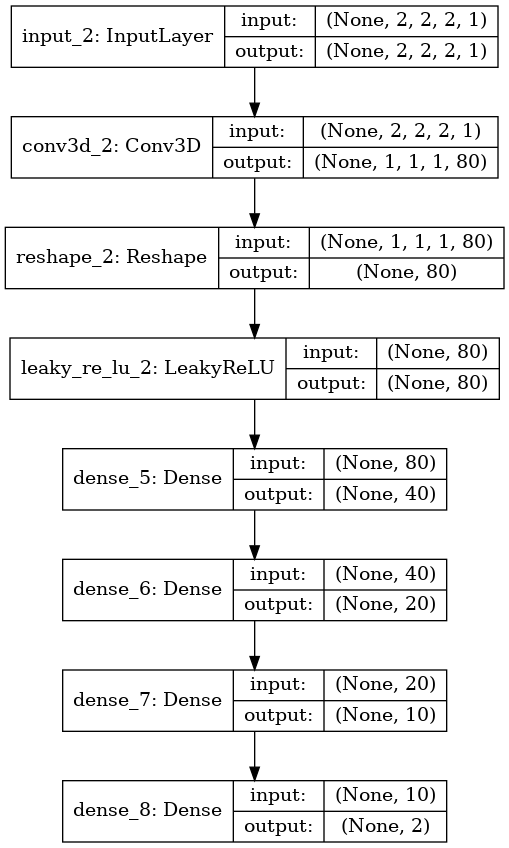

In [14]:
plot_model(model, to_file='3layer_plot_onlySST_timestencil.png', show_shapes=True, show_layer_names=True)

In [15]:
# this will help save training history more frequently
# https://keras.io/callbacks/#create-a-callback

class LossHistory(keras.callbacks.Callback):
    def __init__(self, frequency=100):
        self.frequency = frequency
        self.batch_counter = 0
        self.losses = []
        
    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.mse = []
        self.accuracy = []
        
        self.fig = plt.figure()
        
        self.logs = []
        
    def on_batch_end(self, batch, logs={}):
        if batch % self.frequency == 0:
            self.batch_counter += self.frequency
            self.logs.append(logs)
            self.x.append(self.i)
            self.losses.append(logs.get('loss'))
            self.mse.append(logs.get('mse'))
            self.accuracy.append(logs.get('accuracy'))
        
            self.i += 1
        
            clear_output(wait=True)
            plt.figure(figsize=(18,5))
            plt.subplot(131)
            plt.plot(self.x, self.losses,color=color2,label="loss")
            plt.legend()
            plt.xlabel(r'batch');
            plt.ylabel('Mean Absolute Error');
        
            plt.subplot(132)
            plt.plot(self.x, self.mse)
            plt.xlabel('batch');
            plt.ylabel(r'Mean Squared Error [$cm^2/s^2$]');
        
            plt.subplot(133)
            plt.plot(self.x, self.accuracy,color=color2)
            plt.xlabel('batch');
            plt.ylabel('Model Accuracy');
            plt.show();

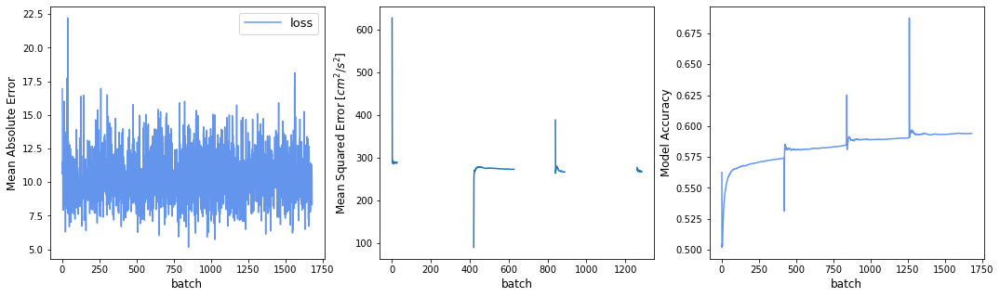

1342934/1342934 [==============================] - 340s 253us/step - loss: nan - mae: nan - mse: nan - accuracy: 0.5941


In [16]:
history = LossHistory()
model.fit(inputs, targets, batch_size=32, epochs=4,callbacks=[history])

In [17]:
# some testing data
features_test, targets_test = prepare_data(ds.isel(time=slice(100, 102)), apply_mask=True, randomize=False)
model.evaluate(features_test, targets_test)

1342934/1342934 [==============================] - 31s 23us/step


[9.862778376709336, 9.862778663635254, 246.80381774902344, 0.598318338394165]

In [18]:
# don't want to mask for making predictions
features_pred, targets_true = prepare_data(ds.isel(time=slice(100, 102)), apply_mask=False, randomize=False)
targets_pred = model.predict(features_pred)

In [19]:
def unstack(data_flat, original_shape, stencil_size, target_index=(0, 0)):
    sub_shape = tuple(np.asarray(original_shape) // stencil_size)
    return data_flat.reshape(sub_shape)

Text(0.5, 1.0, '$U_{pred}$ (from SST time/space-stencil)')

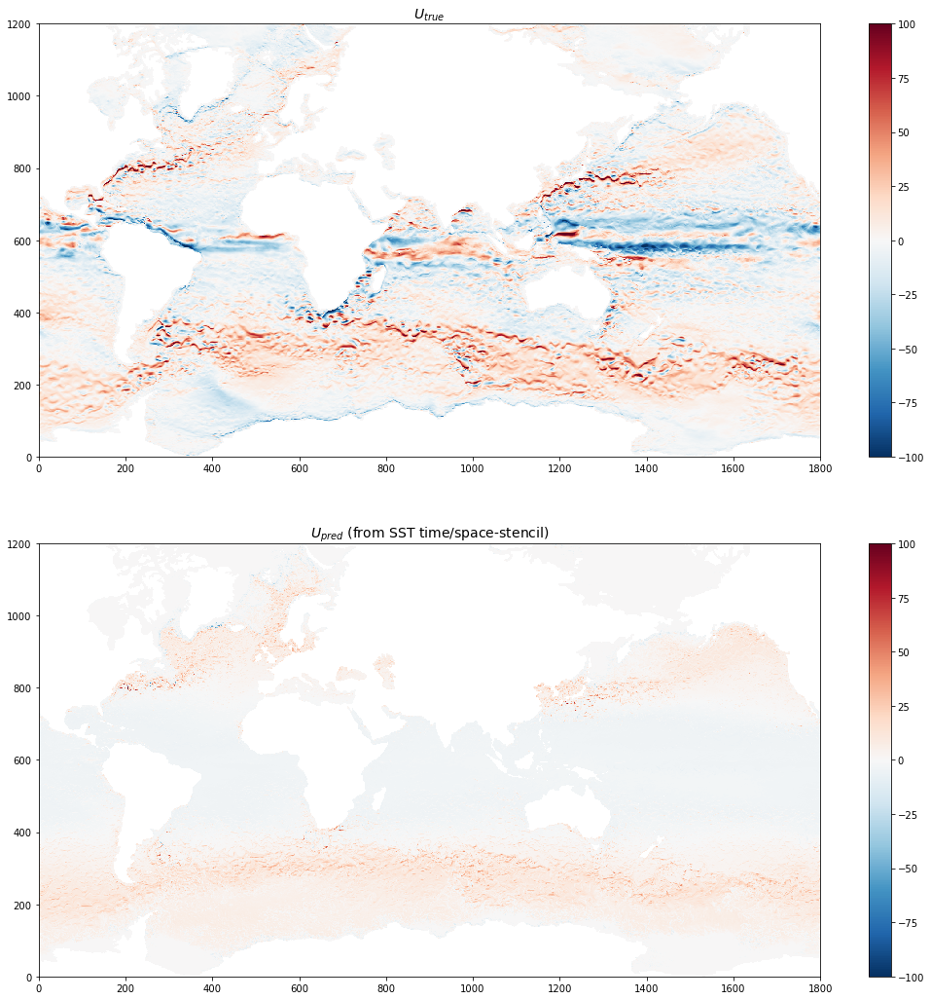

In [20]:
U_true = unstack(targets_true[:, 0], ds.U.shape[1:], 2)
V_true = unstack(targets_true[:, 1], ds.U.shape[1:], 2)
U_pred = unstack(targets_pred[:, 0], ds.U.shape[1:], 2)
V_pred = unstack(targets_pred[:, 1], ds.U.shape[1:], 2)

plt.figure(figsize=(18, 18))
plt.subplot(211)
plt.pcolormesh(U_true, cmap='RdBu_r')
plt.clim([-100, 100])
plt.colorbar()
plt.title(r'$U_{true}$')

plt.subplot(212)
plt.pcolormesh(U_pred, cmap='RdBu_r')
plt.clim([-100, 100])
plt.colorbar()
plt.title(r'$U_{pred}$ (from SST time/space-stencil)')



<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
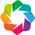

In [78]:
import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import datashade, shade, dynspread, rasterize
import datashader
hv.extension('bokeh')

In [79]:
kdims = ['true (cm/s)', 'predicted (cm/s)']

u_data = np.array([targets_true[:, 0], targets_pred[:, 0]]).transpose()
u_points = hv.Points(u_data, kdims=kdims, label="U")

v_data = np.array([targets_true[:, 1], targets_pred[:, 1]]).transpose()
v_points = hv.Points(v_data, kdims=kdims, label="V")

line_1x1 = hv.Path(np.array([[-150, -150], [150, 150]]), kdims=kdims).opts(color='red', line_width=2)

agg = datashader.mean('rms_vel')
(datashade(u_points, cmap=plt.cm.binary) * line_1x1 +
 datashade(v_points, cmap=plt.cm.binary) * line_1x1 
).opts(opts.RGB(width=400, height=400, show_grid=True))

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .RGB.U  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .RGB.V  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]

In [ ]:
targets_err = targets_pred - targets_true
xc = extract_data_loc(ds.isel(time=100), 'XU', stencil_size, target_index)
yc = extract_data_loc(ds.isel(time=100), 'YU', stencil_size, target_index)

coords = np.stack([xc, yc], axis=1)

In [ ]:

data_lonlat = np.hstack([coords, targets_true[:,0, None], targets_pred[:,0, None], targets_err[:,0, None], 
                         targets_true[:,1, None], targets_pred[:,1, None], targets_err[:,1, None]])
points_lonlat = hv.Points(data_lonlat, kdims=['lon', 'lat'],
                          vdims=['u_true', 'u_pred', 'u_error', 'v_true', 'v_pred', 'v_error'], label="Velocity")

plt_opts = dict(width=1000, height=570, colorbar=True, tools=['hover'])

(rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_true')
          ).redim.range(rms_vel=(-80, 80)).opts(cmap=plt.cm.bwr, title='U True', clim=(-80,80), **plt_opts)
 +              
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_true')
          ).redim.range(rms_vel=(-80, 80)).opts(cmap=plt.cm.bwr,  title='V True', clim=(-80,80),**plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_pred')
          ).redim.range(rms_vel_pred=(-80, 80)).opts(cmap=plt.cm.bwr, title='U Predicted', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_pred')
          ).redim.range(rms_vel_pred=(-80, 80)).opts(cmap=plt.cm.bwr, title='V Predicted', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_error')
          ).opts(cmap=plt.cm.bwr, title='U Error', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_error')
          ).opts(cmap=plt.cm.bwr, title='V Error', clim=(-80,80), **plt_opts)
).cols(2)
           

# Now try providing spatial information (X,Y,Z)

In [80]:
stencil_size = 2

# stencil_vars = ['SSH', 'SST', 'X', 'Y', 'Z']
# stencil_time_vars = ['SSH',]
stencil_time_vars = ['SST',]
stencil_time_index = (slice(None), slice(None), slice(None))

stencil_vars = ['X', 'Y', 'Z']
stencil_index = (slice(None), slice(None))

# point_vars = ['TAUX', 'TAUY']
# point_index = (0, 0)

target_vars = ['U', 'V']
target_index = (0, 0)

def prepare_data(ds, apply_mask=True, randomize=True):
    
    stencil_time_data = [extract_data_in(ds, vname, stencil_size, stencil_time_index)
                    for vname in stencil_time_vars]    
    stencil_data = [extract_data_loc(ds, vname, stencil_size, stencil_index)
                    for vname in stencil_vars]
#     point_data = [extract_data(ds, vname, stencil_size, point_index)
#                    for vname in point_vars]
    target_data = [extract_data_out(ds, vname, stencil_size, target_index)
                   for vname in target_vars]

    if apply_mask:
        mask = np.isnan(stencil_time_data[0]).sum(axis=(1, 2, 3)) == 0
    else:
        mask = slice(None)
    if randomize:
        random_idx = np.random.permutation(mask.sum())
    else:
        random_idx = slice(None)

    features_stencil_time = np.stack([data[mask][random_idx] for data in stencil_time_data],
                                axis=-1)
    features_stencil = np.stack([data[mask][random_idx] for data in stencil_data],
                                axis=-1)
#     features_point = np.stack([data[mask][random_idx] for data in point_data],
#                                axis=-1)
    targets = np.stack([data[mask][random_idx] for data in target_data],
                        axis=-1)
#     return [features_stencil_time], targets
    return [features_stencil_time, features_stencil], targets
#     return [features_stencil, features_point], targets

In [81]:
import keras
keras.backend.set_image_data_format('channels_last')


In [82]:
# prepare test data


inputs, targets = prepare_data(ds.isel(time=slice(10,12)))

In [83]:
# use mutiple different input layers
# https://www.pyimagesearch.com/2019/02/04/keras-multiple-inputs-and-mixed-data/

input_stencil_time = keras.Input(shape=inputs[0].shape[1:])
input_stencil = keras.Input(shape=inputs[1].shape[1:])
# input_points = keras.Input(shape=inputs[1].shape[1:])

nfilters = 80
conv_layer_1 = keras.layers.convolutional.Conv3D(nfilters, 2)(input_stencil_time)
reshape_layer_1 = keras.layers.Reshape((-1,))(conv_layer_1)

nfilters = 80
conv_layer_2 = keras.layers.convolutional.Conv2D(nfilters, 2)(input_stencil)
reshape_layer_2 = keras.layers.Reshape((-1,))(conv_layer_2)


# concat_layer = keras.layers.concatenate([reshape_layer, input_points])
concat_layer = keras.layers.concatenate([reshape_layer_1, reshape_layer_2])
combined_relu = keras.layers.LeakyReLU(alpha=0.3)(concat_layer)
# combined_relu = keras.layers.LeakyReLU(alpha=0.3)(reshape_layer_1)
hidden_layer_1 = keras.layers.Dense(40, activation='relu')(combined_relu)
hidden_layer_2 = keras.layers.Dense(20, activation='relu')(hidden_layer_1)
hidden_layer_3 = keras.layers.Dense(10, activation='relu')(hidden_layer_2)
output_layer = keras.layers.Dense(2)(hidden_layer_3)

# model = keras.Model(inputs=[input_stencil, input_points],
# model = keras.Model(inputs=[input_stencil_time],
model = keras.Model(inputs=[input_stencil_time, input_stencil],
                    outputs=output_layer)

optimizer = tf.train.AdamOptimizer()
model.compile(loss='mae', optimizer=optimizer, metrics=['mae', 'mse','accuracy'])
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 2, 2, 2, 1)   0                                            
__________________________________________________________________________________________________
input_4 (InputLayer)            (None, 2, 2, 3)      0                                            
__________________________________________________________________________________________________
conv3d_3 (Conv3D)               (None, 1, 1, 1, 80)  720         input_3[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 1, 1, 80)     1040        input_4[0][0]                    
____________________________________________________________________________________________

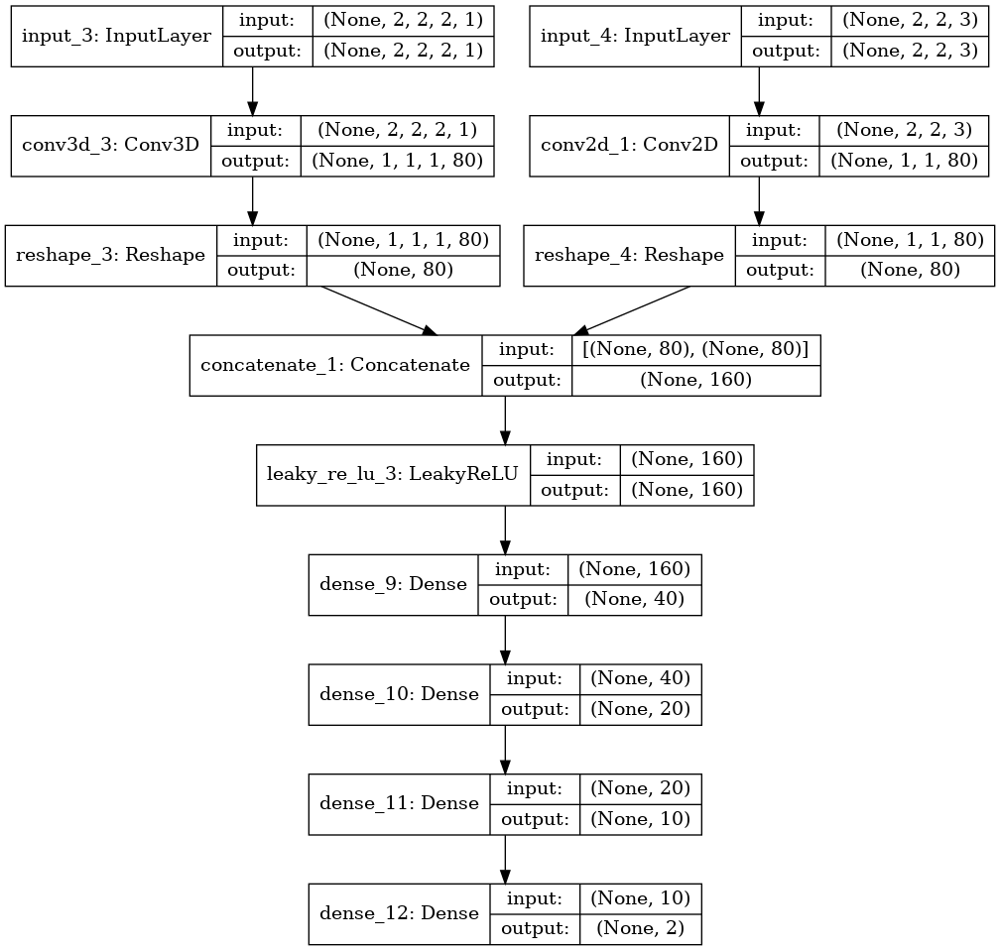

In [84]:
plot_model(model, to_file='3layer_plot_SST_wXYZ_timestencil.png', show_shapes=True, show_layer_names=True)

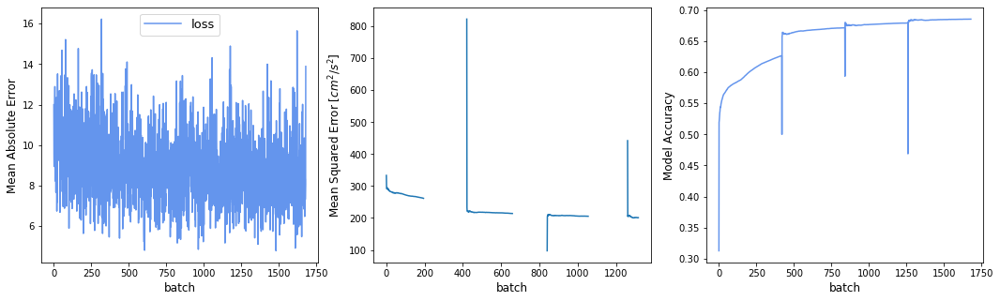

1342934/1342934 [==============================] - 348s 259us/step - loss: nan - mae: nan - mse: nan - accuracy: 0.6858


In [85]:
history = LossHistory()
model.fit(inputs, targets, batch_size=32, epochs=4,callbacks=[history])

In [86]:
# some testing data
features_test, targets_test = prepare_data(ds.isel(time=slice(100, 102)), apply_mask=True, randomize=False)
model.evaluate(features_test, targets_test)

1342934/1342934 [==============================] - 35s 26us/step


[9.811019377063204, 9.811050415039062, 233.68263244628906, 0.6003504395484924]

In [87]:
# don't want to mask for making predictions
features_pred, targets_true = prepare_data(ds.isel(time=slice(100, 102)), apply_mask=False, randomize=False)
targets_pred = model.predict(features_pred)

Text(0.5, 1.0, '$U_{pred}$ (from SST time/space-stencil w X,Y,Z)')

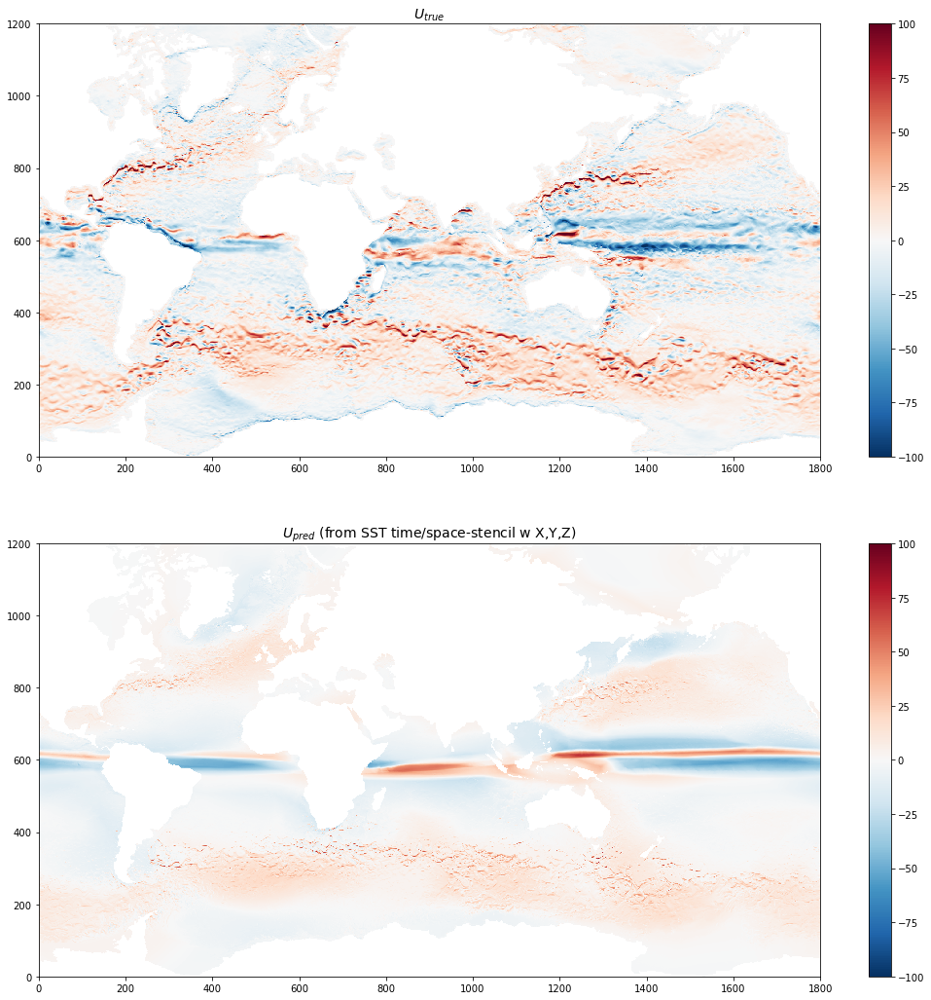

In [88]:
U_true = unstack(targets_true[:, 0], ds.U.shape[1:], 2)
V_true = unstack(targets_true[:, 1], ds.U.shape[1:], 2)
U_pred = unstack(targets_pred[:, 0], ds.U.shape[1:], 2)
V_pred = unstack(targets_pred[:, 1], ds.U.shape[1:], 2)

plt.figure(figsize=(18, 18))
plt.subplot(211)
plt.pcolormesh(U_true, cmap='RdBu_r')
plt.clim([-100, 100])
plt.colorbar()
plt.title(r'$U_{true}$')

plt.subplot(212)
plt.pcolormesh(U_pred, cmap='RdBu_r')
plt.clim([-100, 100])
plt.colorbar()
plt.title(r'$U_{pred}$ (from SST time/space-stencil w X,Y,Z)')



In [89]:
kdims = ['true (cm/s)', 'predicted (cm/s)']

u_data = np.array([targets_true[:, 0], targets_pred[:, 0]]).transpose()
u_points = hv.Points(u_data, kdims=kdims, label="U")

v_data = np.array([targets_true[:, 1], targets_pred[:, 1]]).transpose()
v_points = hv.Points(v_data, kdims=kdims, label="V")

line_1x1 = hv.Path(np.array([[-150, -150], [150, 150]]), kdims=kdims).opts(color='red', line_width=2)

agg = datashader.mean('rms_vel')
(datashade(u_points, cmap=plt.cm.binary) * line_1x1 +
 datashade(v_points, cmap=plt.cm.binary) * line_1x1 
).opts(opts.RGB(width=400, height=400, show_grid=True))

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .RGB.U  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .RGB.V  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]

In [90]:
targets_err = targets_pred - targets_true
xc = extract_data_loc(ds.isel(time=100), 'XU', stencil_size, target_index)
yc = extract_data_loc(ds.isel(time=100), 'YU', stencil_size, target_index)

coords = np.stack([xc, yc], axis=1)

In [91]:

data_lonlat = np.hstack([coords, targets_true[:,0, None], targets_pred[:,0, None], targets_err[:,0, None], 
                         targets_true[:,1, None], targets_pred[:,1, None], targets_err[:,1, None]])
points_lonlat = hv.Points(data_lonlat, kdims=['lon', 'lat'],
                          vdims=['u_true', 'u_pred', 'u_error', 'v_true', 'v_pred', 'v_error'], label="Velocity")

plt_opts = dict(width=1000, height=570, colorbar=True, tools=['hover'])

(rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_true')
          ).redim.range(rms_vel=(-80, 80)).opts(cmap=plt.cm.bwr, title='U True', clim=(-80,80), **plt_opts)
 +              
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_true')
          ).redim.range(rms_vel=(-80, 80)).opts(cmap=plt.cm.bwr,  title='V True', clim=(-80,80),**plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_pred')
          ).redim.range(rms_vel_pred=(-80, 80)).opts(cmap=plt.cm.bwr, title='U Predicted', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_pred')
          ).redim.range(rms_vel_pred=(-80, 80)).opts(cmap=plt.cm.bwr, title='V Predicted', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_error')
          ).opts(cmap=plt.cm.bwr, title='U Error', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_error')
          ).opts(cmap=plt.cm.bwr, title='V Error', clim=(-80,80), **plt_opts)
).cols(2)
           

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [lon,lat]   (u_true)
   .DynamicMap.II  :DynamicMap   []
      :Image   [lon,lat]   (v_true)
   .DynamicMap.III :DynamicMap   []
      :Image   [lon,lat]   (u_pred)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [lon,lat]   (v_pred)
   .DynamicMap.V   :DynamicMap   []
      :Image   [lon,lat]   (u_error)
   .DynamicMap.VI  :DynamicMap   []
      :Image   [lon,lat]   (v_error)

In [21]:
ds0 = ds.isel(time=slice(10,12))
stencil_time_data = [extract_data_in(ds0, vname, stencil_size, stencil_time_index)
                    for vname in stencil_time_vars]    

target_data = [extract_data_out(ds0, vname, stencil_size, target_index)
                   for vname in target_vars]
mask = np.isnan(stencil_time_data[0]).sum(axis=(1, 2, 3)) == 0
random_idx = np.random.permutation(mask.sum())

In [22]:
features_stencil_time = np.stack([data[mask] for data in stencil_time_data],
                            axis=-1)
targets = np.stack([data[mask] for data in target_data],
                    axis=-1)

In [39]:
features_stencil_time_nomask = np.stack([data for data in stencil_time_data],
                            axis=-1)
targets_nomask = np.stack([data for data in target_data],
                    axis=-1)

In [30]:
stencil_time_data[0].shape

(2160000, 2, 2, 2)

In [35]:
target_data[0].shape

(2160000,)

In [38]:
features_stencil_time.shape

(1342934, 2, 2, 2, 1)

In [40]:
features_stencil_time_nomask.shape

(2160000, 2, 2, 2, 1)

In [37]:
targets.shape

(1342934, 2)

In [ ]:
def unstack(data_flat, original_shape, stencil_size, target_index=(0, 0)):
    sub_shape = tuple(np.asarray(original_shape) // stencil_size)
    return data_flat.reshape(sub_shape)

In [52]:

SST000 = unstack(stencil_time_data[0][:,0,0,0], ds.U.shape[1:], 2)

In [56]:
SST_true = np.zeros((U_true.shape[0],U_true.shape[1],2,2,2))
for i in range(2):
    for j in range(2):
        for it in range(2):
            SST_true[:,:,i,j,it] = unstack(stencil_time_data[0][:,i,j,it], ds.U.shape[1:], 2)

In [61]:
SST_true = {}

# np.zeros((U_true.shape[0],U_true.shape[1],2,2,2))
for i in range(2):
    for j in range(2):
        for it in range(2):
            SST_true[str(i)+str(j)+str(it)] = unstack(stencil_time_data[0][:,i,j,it], ds.U.shape[1:], 2)

In [63]:
SST_true.keys()

dict_keys(['000', '001', '010', '011', '100', '101', '110', '111'])

In [66]:
SST_true['000'].shape

(1200, 1800)

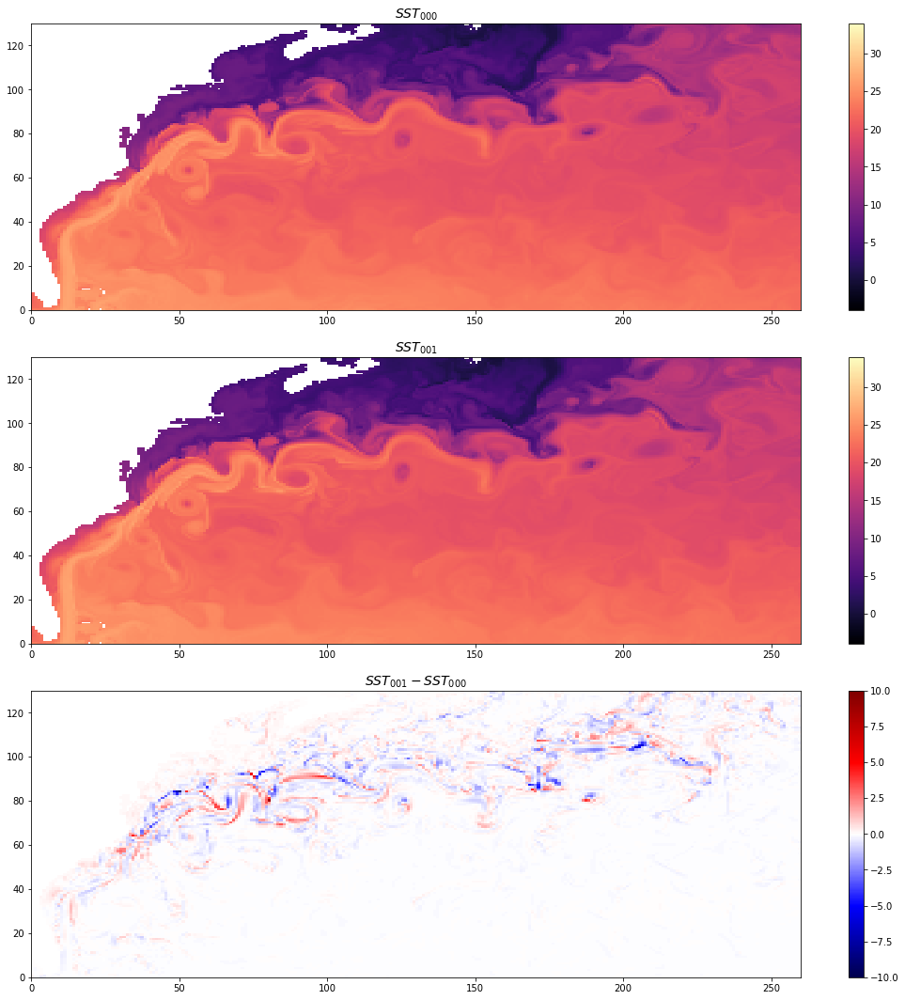

In [76]:
plt.figure(figsize=(15, 15))
plt.subplot(3,1,1)
plt.pcolormesh(SST_true['000'][720:850,140:400], cmap='magma')
plt.clim([-4, 34])
plt.colorbar()
plt.title(r'$SST_{000}$')

plt.subplot(3,1,2)
plt.pcolormesh(SST_true['001'][720:850,140:400], cmap='magma')
plt.clim([-4, 34])
plt.colorbar()
plt.title(r'$SST_{001}$')

plt.subplot(3,1,3)
plt.pcolormesh((SST_true['001']-SST_true['000'])[720:850,140:400], cmap='seismic')
plt.clim([-10, 10])
plt.colorbar()
plt.title(r'$SST_{001} - SST_{000}$')


plt.tight_layout()

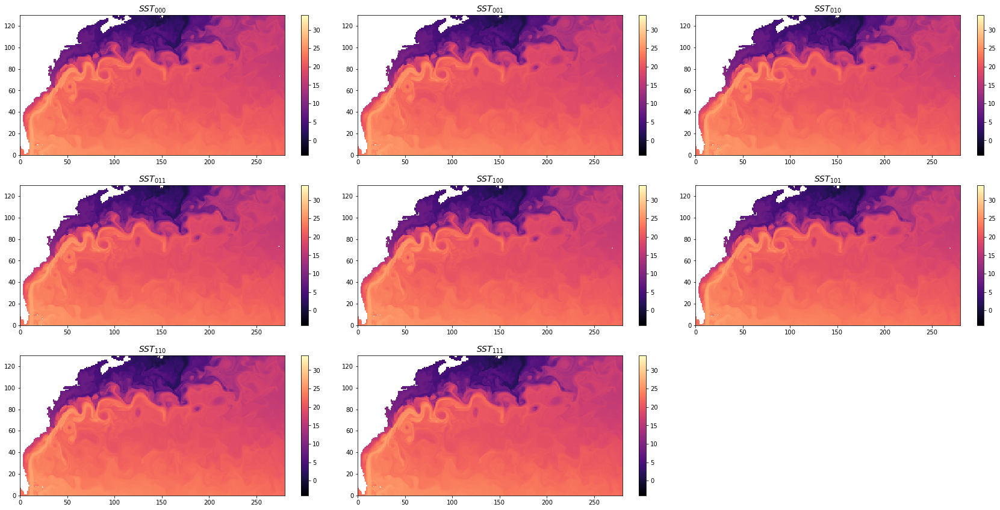

In [72]:
plt.figure(figsize=(24, 12))
for i , vt in enumerate(SST_true.keys()):
    plt.subplot(3,3,i+1)
    plt.pcolormesh(SST_true[vt][720:850,140:420], cmap='magma')
    plt.clim([-4, 34])
    plt.colorbar()
    plt.title(r'$SST_{%s}$' %vt)
plt.tight_layout()

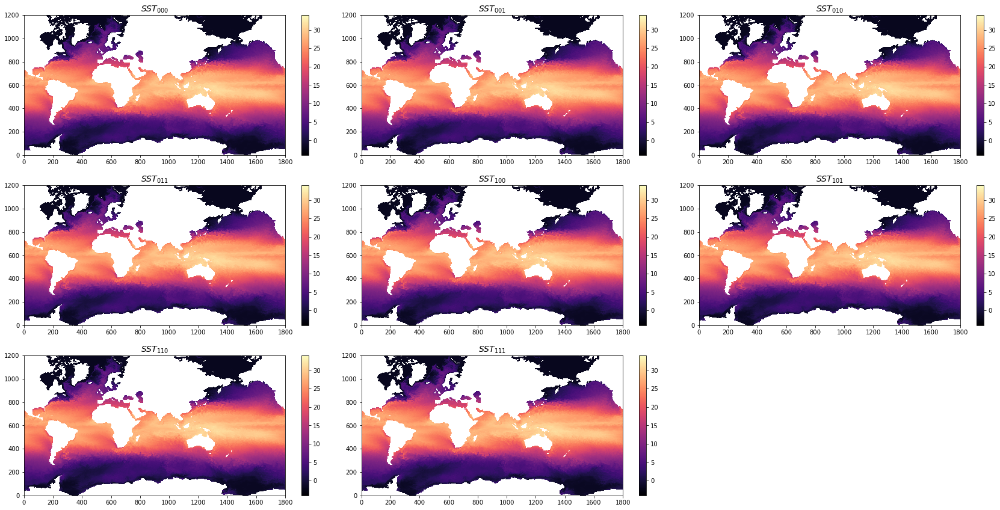

In [65]:
plt.figure(figsize=(24, 12))
for i , vt in enumerate(SST_true.keys()):
    plt.subplot(3,3,i+1)
    plt.pcolormesh(SST_true[vt], cmap='magma')
    plt.clim([-4, 34])
    plt.colorbar()
    plt.title(r'$SST_{%s}$' %vt)
plt.tight_layout()

Text(0.5, 1.0, '$SST_{0,0,0}$')

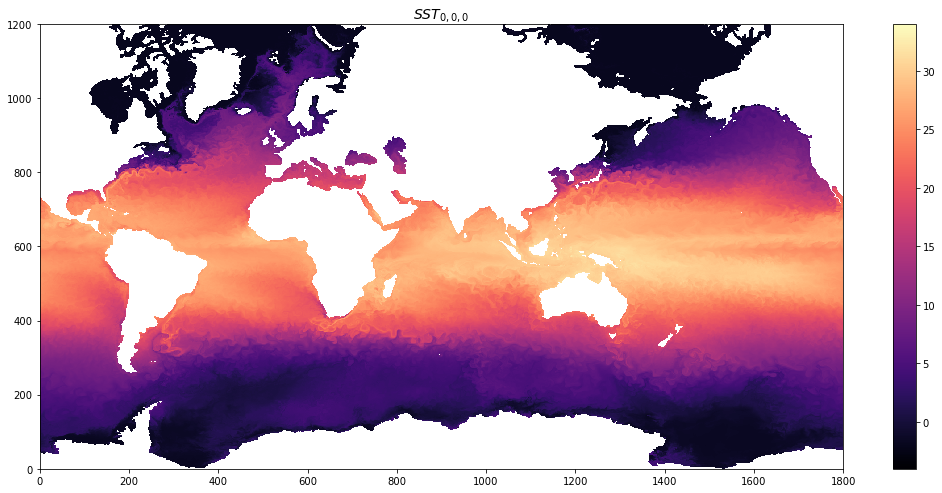

In [55]:
plt.figure(figsize=(18, 18))
plt.subplot(211)
plt.pcolormesh(SST000, cmap='magma')
plt.clim([-4, 34])
plt.colorbar()
plt.title(r'$SST_{0,0,0}$')

In [49]:
stencil_time_data[0][:,0,0,0].shape

(2160000,)

(1200, 1800)